## Embedded Image Processing - Mini Project
-------------
Name: Vijaya Vignesh Sankar

Student ID: 22225482

### Loading Necessary packages
----------

*** NOTES ***

--------------
sys.path.insert() adds a new path to the Python interpreter's search path. The new path is 'D:\\Jupyter\\topview input images\\sample_small\\robotcar-dataset-sdk\\python'. This allows Python to find modules or packages located in this directory when they are imported in the code. This code specifically adds the path to the RobotCar Dataset SDK Python package.

In [305]:
import sys
import os
import cv2
import numpy as np
import matplotlib.pylab as plt
from PIL import Image
import tensorflow as tf
from skimage import transform
from IPython.display import display
import requests
import warnings
warnings.filterwarnings('ignore')
sys.path.insert(1, 'D:\\Jupyter\\topview input images\\sample_small\\robotcar-dataset-sdk\\python')

from camera_model import CameraModel as CM
import image as Image
import road_boundary

*** NOTES ****

----------------------
I have used the git repo shared in the project details as re-implementing the same doesnt makes sense. So, imported distored function and load image as
CameraModel.undistort(...) and Image.loadimage(...) to undistort a loaded image using former and latter functions.

### Get and Set paths To Image locations

In [50]:
# Get the current working directory
CD = os.getcwd()

# Define the paths for the robotcar dataset model, the mono_right camera, 
# the stereo images, the mono_left camera, the mono_right camera and the mono_rear camera
CM_path = os.path.join(CD, "robotcar-dataset-sdk\\models")
mono_right_camera_path = os.path.join(CM_path, "mono_right.txt")
stereo_image_path = os.path.join(CD, "stereo\\centre")
mono_left_path = os.path.join(CD, "mono_left")
mono_right_path = os.path.join(CD, "mono_right")
mono_rear_path = os.path.join(CD, "mono_rear")

# Load the camera models for the mono_right, stereo and mono_rear cameras
# using the CameraModel class from the robotcar-dataset-sdk library
mono_side_camera = CM(CM_path, mono_right_path)
stereo_image_camera = CM(CM_path, stereo_image_path)
mono_rear_camera = CM(CM_path, mono_rear_path)


#### Universal utility Function to plot images
-------------

In [231]:
def show(img, label = None):
    im = img
    if im.dtype == np.float64:
        im = (im * 255).astype(np.uint8)
    plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    plt.title(label)
    plt.axis('off')
    plt.show()
    display(plt.gcf()) # create new cells to not overwrite previous image plot


### Convert Image to numpy arrays and store them
---------

In [257]:
def get_first_images(path, model = None):
    # List to store the image paths
    image_files = []

    # Loop over each image and add the first file to the list
    for file_list in os.listdir(path):
        if file_list.endswith('png'):
            path1 = os.path.join(path, file_list)
            
            # Load the image using the Image class from the robotcar-dataset-sdk library
            arr = Image.load_image(path1)
            
            # Apply undistortion using the camera model if provided
            if model is not None:
                arr = model.undistort(arr)
            arr = cv2.resize(arr, (640, 480))
            # Add the image array to the list of image files
            image_files.append(arr)
    
    # Show the first image
    show(image_files[0])
    
    # Return the list of image arrays
    return image_files


#### Stereo image sample

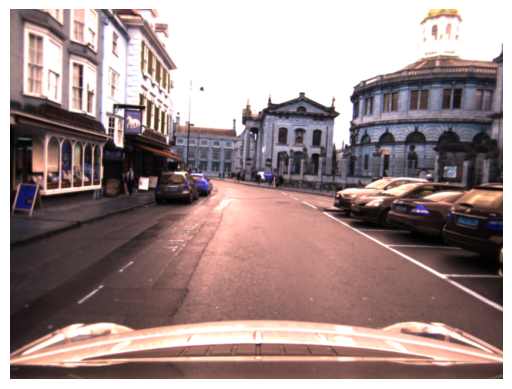

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [239]:
stereo_images = get_first_images(stereo_image_path, model = stereo_image_camera)

#### Left image sample

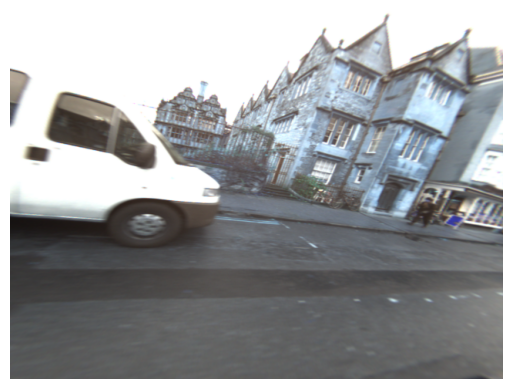

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [240]:
left_images = get_first_images(mono_left_path, model = mono_side_camera)

#### Right image sample

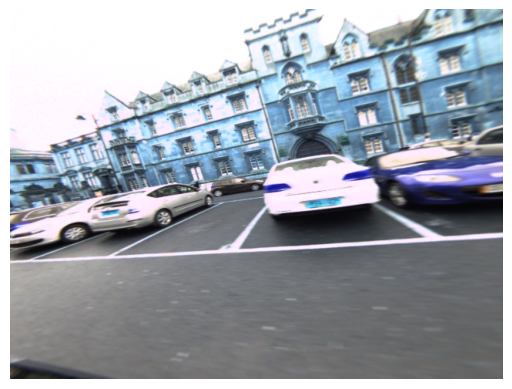

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [241]:
right_images = get_first_images(mono_right_path, model = mono_side_camera)

#### Rear image sample

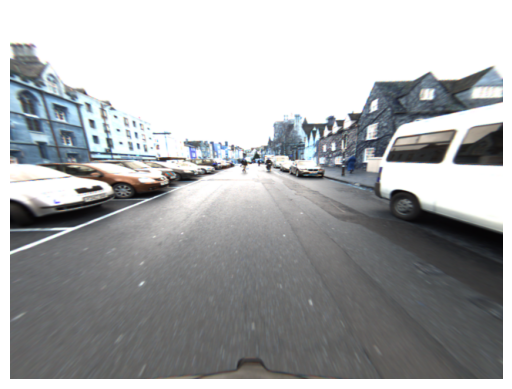

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [242]:
rear_images = get_first_images(mono_rear_path, model = mono_rear_camera)

### Task 1
--------------

### Plan to generate top view
-------
1. Perspective transformation: The first step is to transform the images from the multiple cameras into a unified perspective. This involves mapping the pixels in the images to a 2D plane that represents the top-down view of the car. Homography transformation can be used to map the points in the images onto the top-down view.

2. Image stitching: Once the images are transformed into a unified perspective, you can stitch them together to create a panoramic view of the car. This involves finding corresponding points in the images and warping them to align with each other. It is also called as blending

In [335]:
def perspective_transform(image, src_points, dst_points, rotation=0):
    # Rotate the image based on the specified rotation angle
    image = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE * rotation)

    # Calculate the minimum and maximum x and y values of the source points
    min_x, min_y = np.min(src_points, axis=0)
    max_x, max_y = np.max(src_points, axis=0)

    # Crop the section of the image defined by the source points
    cropped_image = image[min_y:max_y, min_x:max_x]

    # Calculate the new source points based on the cropped image
    new_src_points = np.array(
        [
            [0, 0],
            [max_x - min_x, 0],
            [max_x - min_x, max_y - min_y],
            [0, max_y - min_y]
        ], dtype=np.float32
    )

    # Calculate the perspective transformation matrix
    transformation_matrix = cv2.getPerspectiveTransform(new_src_points, dst_points)

    # Apply the perspective transformation to the input image
    transformed_image = cv2.warpPerspective(cropped_image, transformation_matrix, (800, 800))

    return transformed_image




### Defining Source and Destination points
-----------

In [316]:
right_src_pts = np.float32(
    [
        [50, 0],
        [200, 0],
        [200, 640],
        [50, 640]
    ]
)
right_dst_pts = np.float32(
    [
        [600, 200],
        [800, 0],
        [800, 800],
        [600, 600],
    ]
)
stereo_src_pts = np.float32(
[
[0, 320],
[640, 320],
[640, 440],
[0, 440]
]
)

stereo_dst_pts = np.float32(
[
[0, 0],
[800, 0],
[500, 300],
[300, 300],
]
)
rear_src_pts = np.float32([
[0, 0],
[640, 0],
[640, 120],
[0, 180]
]
)

rear_dst_pts = np.float32(
[
[300, 500],
[500, 500],
[800, 800],
[0, 800],
]
)


right_src_pts = np.float32(
[
[0, 0],
[180, 0],
[180, 440],
[0, 440]
]
)

right_dst_pts = np.float32(
[
[500, 300],
[800, 0],
[800, 800],
[500, 500],
]
)
left_src_pts = np.float32(
[
[320, 0],
[480, 0],
[480, 640],
[320, 640]
]
)
left_dst_pts = np.float32(
[
[0, 0],
[300, 300],
[300, 500],
[0, 800],
]
)





#### Get Perspective transform - Converting image to bird view perspective
----------

### Show right image top view

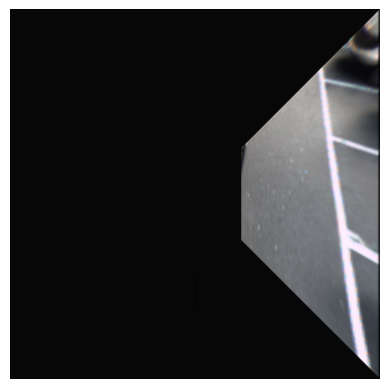

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [326]:
transformr = perspective_transform(right_images[0], right_src_pts, right_dst_pts, rotation=3)
show(transformr)

### Show stereo image top view

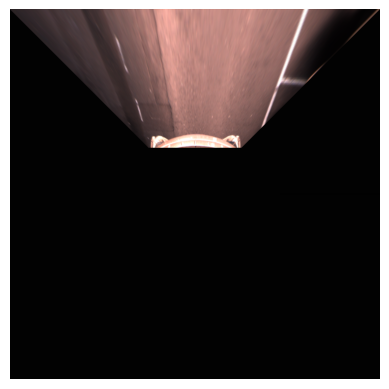

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [324]:
transforms = perspective_transform(stereo_images[0], stereo_src_pts, stereo_dst_pts, rotation = 0)
show(transforms)

### Show left image top view

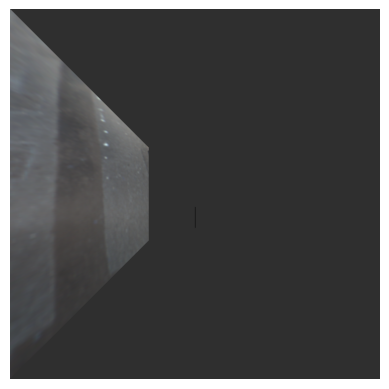

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [323]:
transforml = perspective_transform(left_images[0], left_src_pts, left_dst_pts, rotation=1)
show(transforml)

### Show right image top view

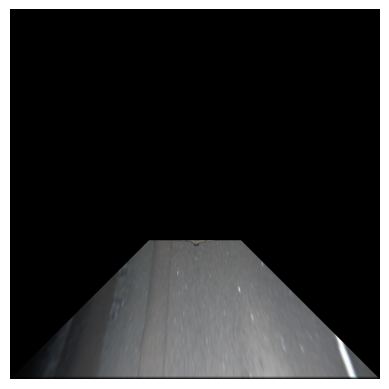

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [327]:
transformb = perspective_transform(rear_images[0], rear_src_pts, rear_dst_pts, rotation=2)
show(transformb)

### Show Final blended Image
-----------

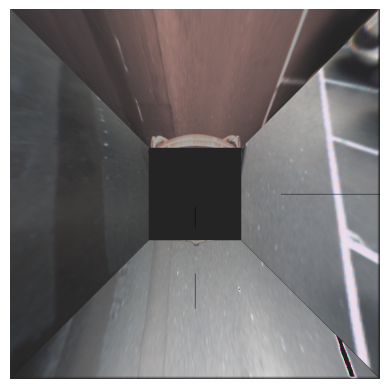

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [331]:
bl = cv2.addWeighted(transforms, 0.8, transforml, 1, 0)
bl = cv2.addWeighted(bl, 0.8, transformr, 1, 0)
bl = cv2.addWeighted(bl, 0.8, transformb, 1, 0)
show(bl)

### Encapsulating them under a single function to get top view of all images and blend them
-------------
This function get perspective transform of all stereo, left, right, rear camera images and blend them together

In [333]:
def birdview(stereo, left, right, rear, alpha = 0.8, beta = 1):
   #transform all camera images to bird view
   transforms = perspective_transform(stereo, stereo_src_pts, stereo_dst_pts, rotation = 0)
   transformr = perspective_transform(right, right_src_pts, right_dst_pts, rotation=3)
   transforml = perspective_transform(left, left_src_pts, left_dst_pts, rotation=1)
   transformb = perspective_transform(rear, rear_src_pts, rear_dst_pts, rotation=2)

   #blend stereo with left, left with right, right with rear
   bl = cv2.addWeighted(transforms, alpha, transforml, beta, 0)
   bl = cv2.addWeighted(bl, alpha, transformr, beta, 0)
   bl = cv2.addWeighted(bl, alpha, transformb, beta, 0)
   show(bl)
   

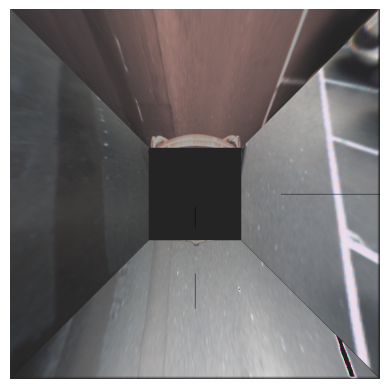

<Figure size 640x480 with 0 Axes>

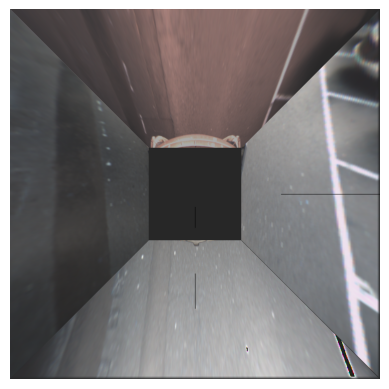

<Figure size 640x480 with 0 Axes>

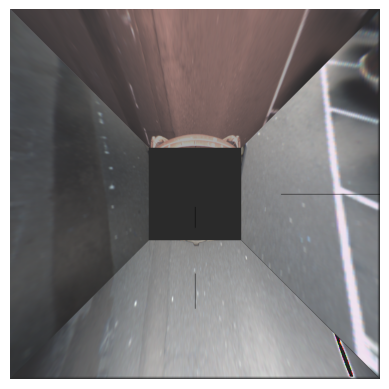

<Figure size 640x480 with 0 Axes>

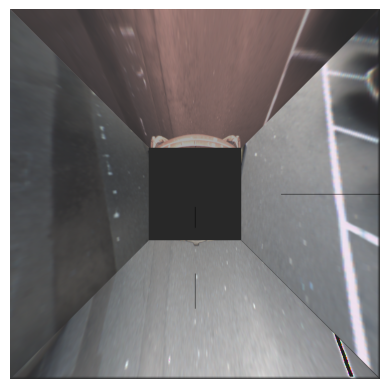

<Figure size 640x480 with 0 Axes>

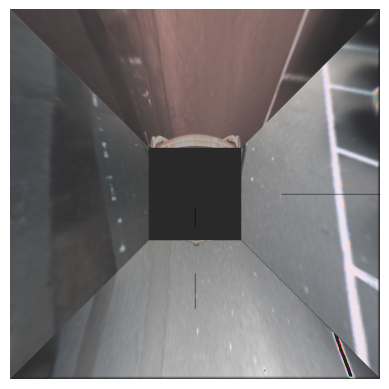

<Figure size 640x480 with 0 Axes>

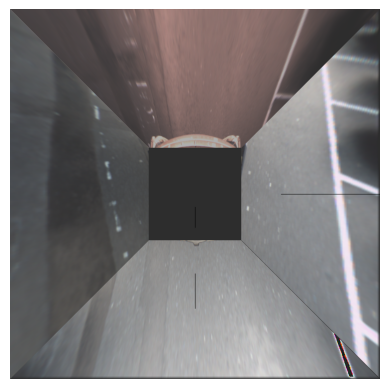

<Figure size 640x480 with 0 Axes>

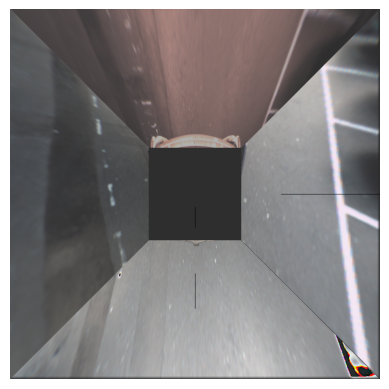

<Figure size 640x480 with 0 Axes>

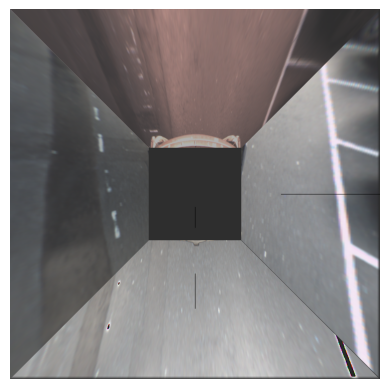

<Figure size 640x480 with 0 Axes>

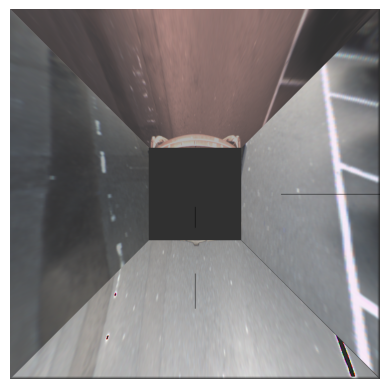

<Figure size 640x480 with 0 Axes>

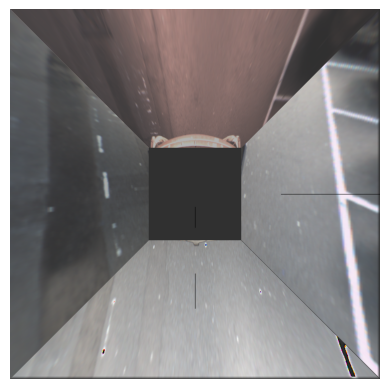

<Figure size 640x480 with 0 Axes>

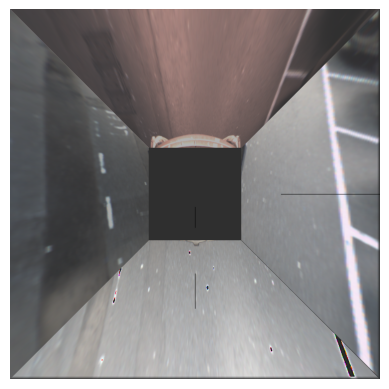

<Figure size 640x480 with 0 Axes>

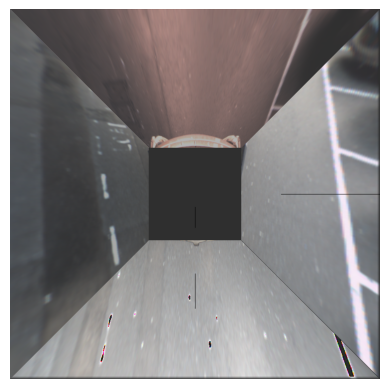

<Figure size 640x480 with 0 Axes>

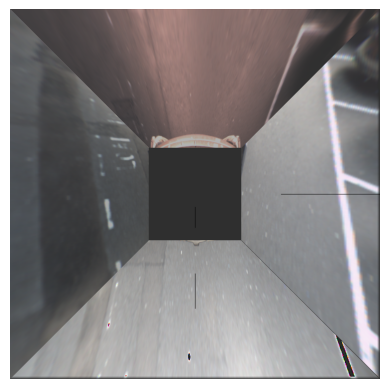

<Figure size 640x480 with 0 Axes>

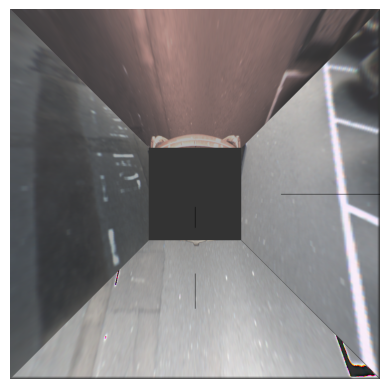

<Figure size 640x480 with 0 Axes>

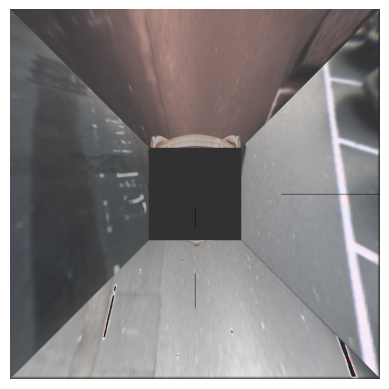

<Figure size 640x480 with 0 Axes>

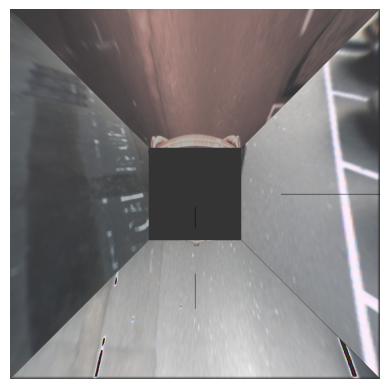

<Figure size 640x480 with 0 Axes>

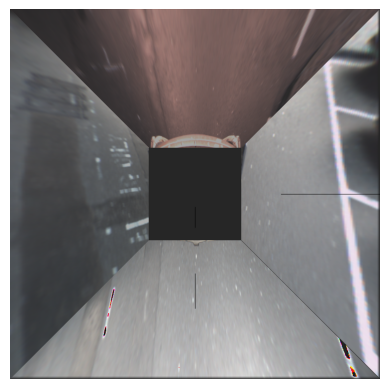

<Figure size 640x480 with 0 Axes>

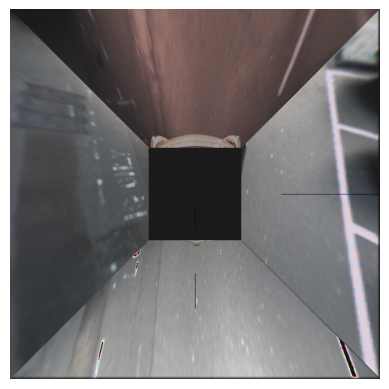

<Figure size 640x480 with 0 Axes>

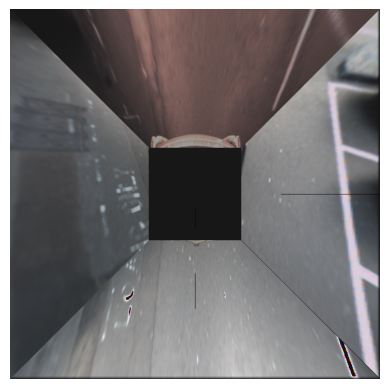

<Figure size 640x480 with 0 Axes>

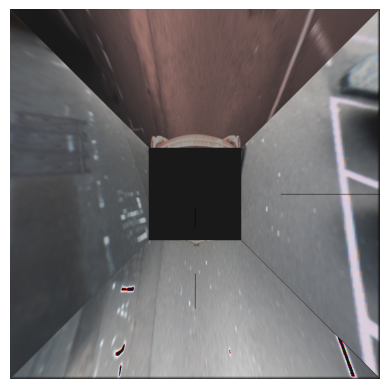

<Figure size 640x480 with 0 Axes>

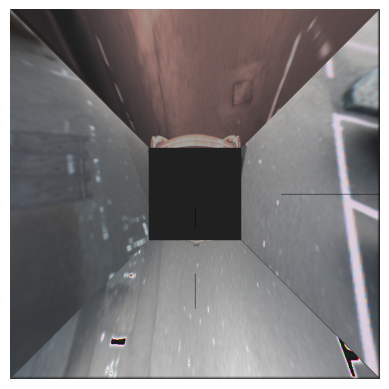

<Figure size 640x480 with 0 Axes>

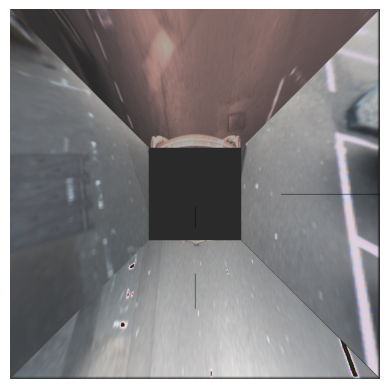

<Figure size 640x480 with 0 Axes>

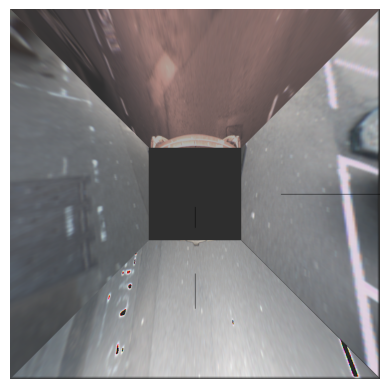

<Figure size 640x480 with 0 Axes>

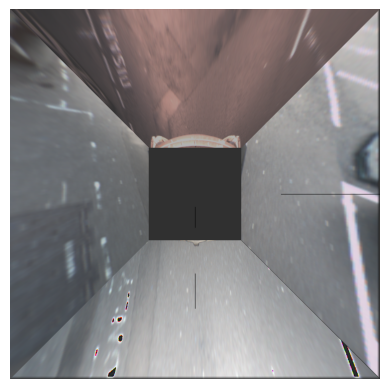

<Figure size 640x480 with 0 Axes>

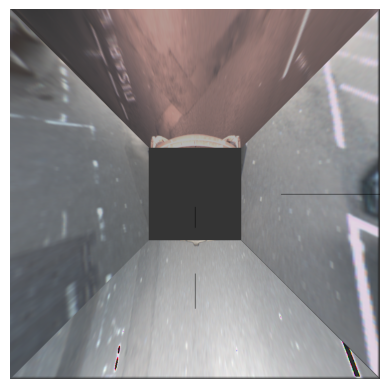

<Figure size 640x480 with 0 Axes>

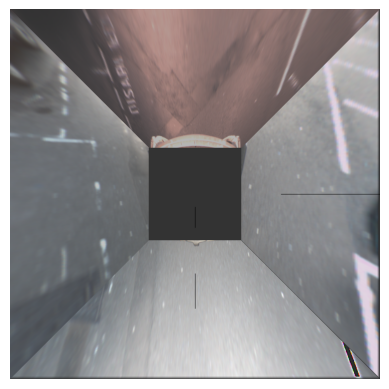

<Figure size 640x480 with 0 Axes>

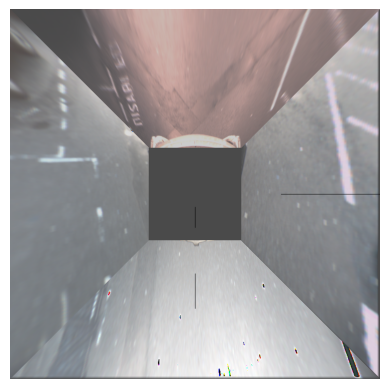

<Figure size 640x480 with 0 Axes>

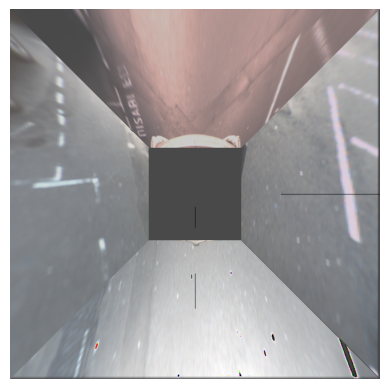

<Figure size 640x480 with 0 Axes>

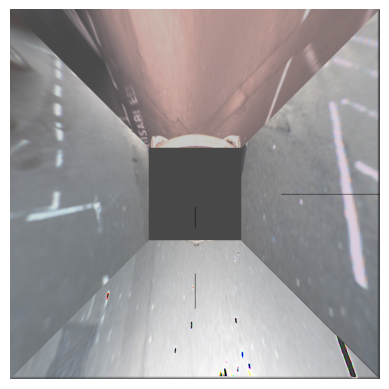

<Figure size 640x480 with 0 Axes>

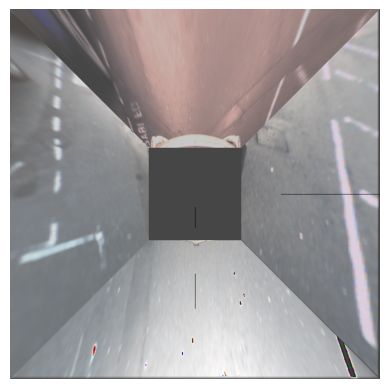

<Figure size 640x480 with 0 Axes>

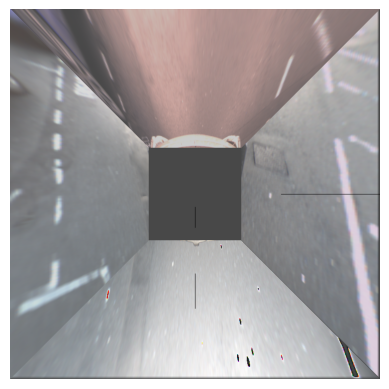

<Figure size 640x480 with 0 Axes>

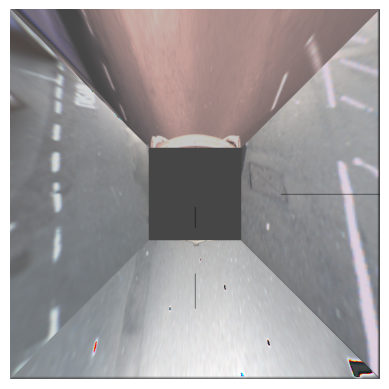

<Figure size 640x480 with 0 Axes>

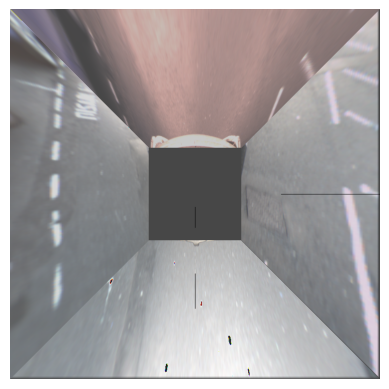

<Figure size 640x480 with 0 Axes>

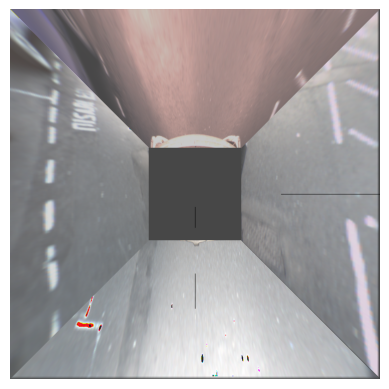

<Figure size 640x480 with 0 Axes>

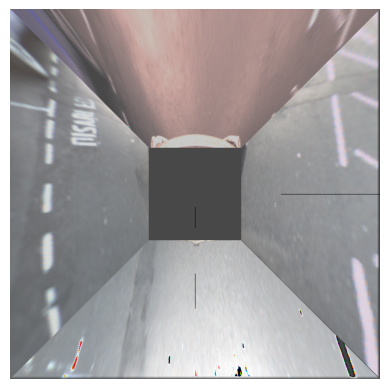

<Figure size 640x480 with 0 Axes>

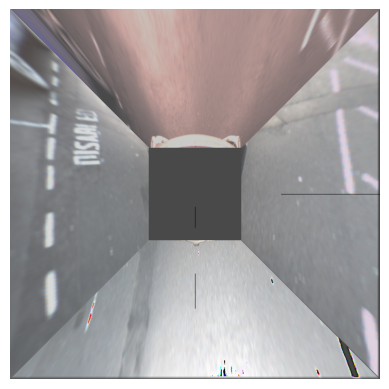

<Figure size 640x480 with 0 Axes>

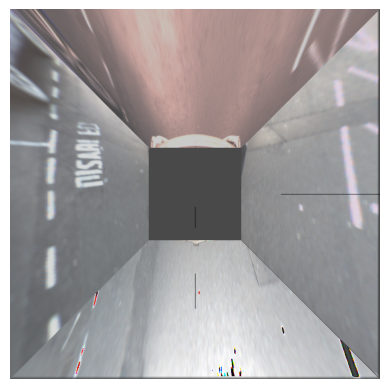

<Figure size 640x480 with 0 Axes>

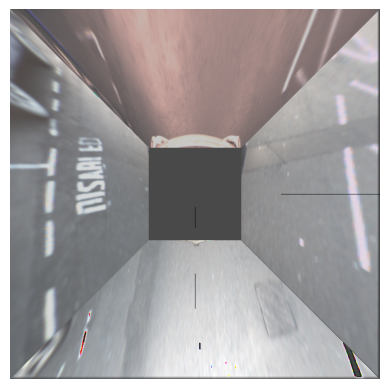

<Figure size 640x480 with 0 Axes>

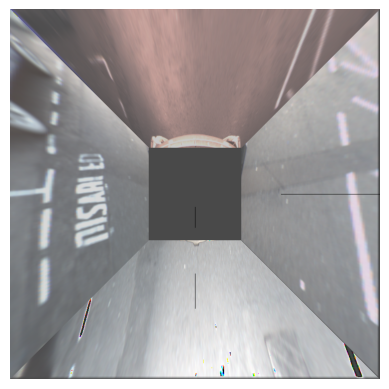

<Figure size 640x480 with 0 Axes>

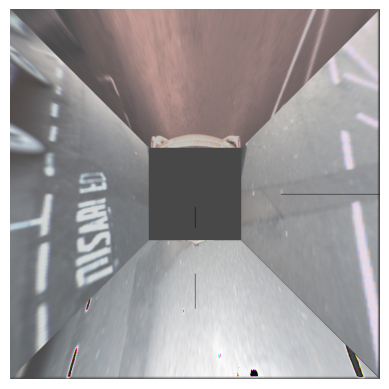

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [334]:
for i, j , k, l in zip(stereo_images, left_images, right_images, rear_images):
    birdview(i, j, k, l)

### Results
------
The results of bird view images seems that they need more allignment to get the perfect top view. Additionaly, there should be some colour and hue correction so the overall blended image looks neat and orginal. Better results can be improved as follows

### Areas of improvement - Bird View
------------

1. One way to improve the top view in the given code could be to use a higher resolution output shape for the warped image. The current code uses an output shape of (800, 800), which may result in a loss of detail and accuracy in the final image. Increasing the resolution could improve the quality of the top view.

2. Additionally, we can experiment with different sets of source and destination points for the perspective transformation to fine-tune the output image. This could involve adjusting the points to better match the specific camera setup and angle of view.

3. Another approach could be to incorporate object detection and segmentation to enhance the output of the top view. This could help to better highlight and differentiate different from cars

### TASK 2
---------

#### CAR DETECTION - USING YOLO
-------------------------------------

 In order to identify cars in an image, this Python programme implements the YOLO (You Only Look Once) technique. The script loads pre-trained YOLOv3 weights and configurations before processing an image to identify objects using forward network propagation. Only boxes for automobiles are drawn by the script, which detects cars by determining the class with the greatest score. After removing any unnecessary boxes with Non-maximum Suppression, the image is displayed with the recognized cars highlighted in red.

In [60]:
# Load Yolo
print("LOADING YOLO")
net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")
# save all the names in file o the list classes
classes = []
with open("coco.names", "r") as f:
    classes = [line.strip() for line in f.readlines()]
# get layers of the network
layer_names = net.getLayerNames()
    # Determine the output layer names from the YOLO model
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
print("YOLO LOADED")

def detect_cars(image_array):

     """
    Detects cars in an input image and draws bounding boxes around them.

    Args:
        image_array: A NumPy array representing an image in RGB format.

    """
    # Read image
    img = image_array.copy()

    # Get image dimensions
    height, width, channels = img.shape

    # Using blob function of opencv to preprocess image
    blob = cv2.dnn.blobFromImage(img, 1 / 255.0, (416, 416), swapRB=True, crop=False)

    # Detecting objects
    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing information on the screen
    class_ids = []
    confidences = []
    boxes = []

    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                # Object detected
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    # We use NMS function in opencv to perform Non-maximum Suppression
    # We give it score threshold and nms threshold as arguments.
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    # Define colors for different classes
    colors = np.random.uniform(0, 255, size=(len(classes), 3))

    # Loop through all detected boxes and draw them
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])

            # Only draw boxes for cars
            if label == 'car':
                label = label.capitalize()  # Capitalize the label text
                color = (0, 0, 139)  # (B, G, R) values for dark red color

                cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
                cv2.putText(img, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX,
                            2, color, 2)
    show(img)

LOADING YOLO
YOLO LOADED


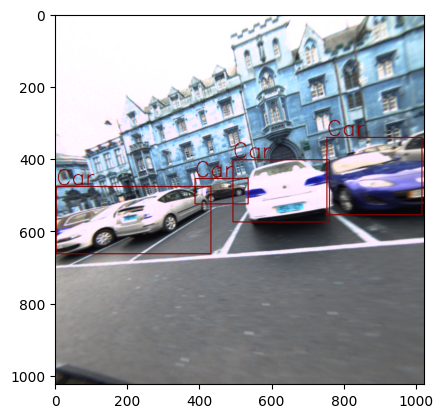

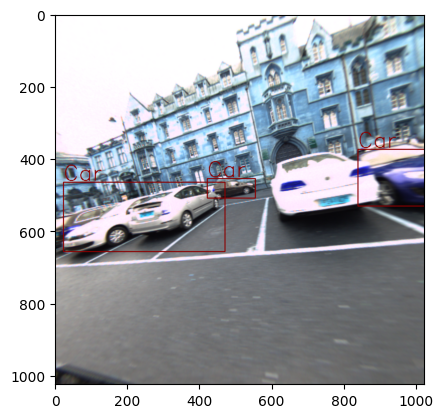

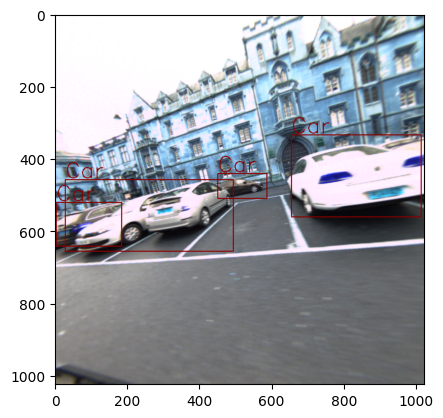

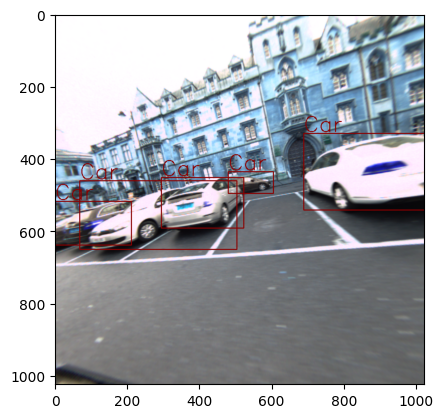

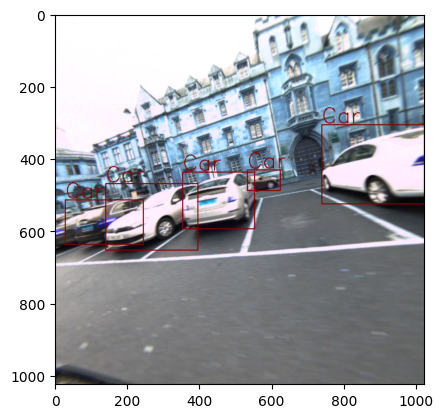

...

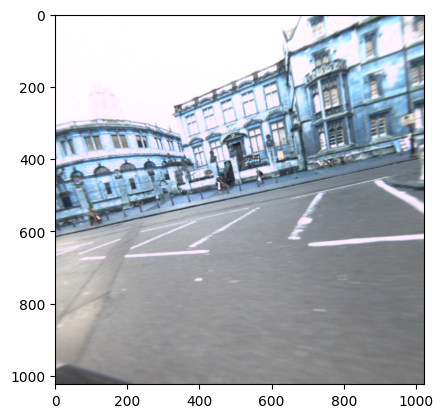

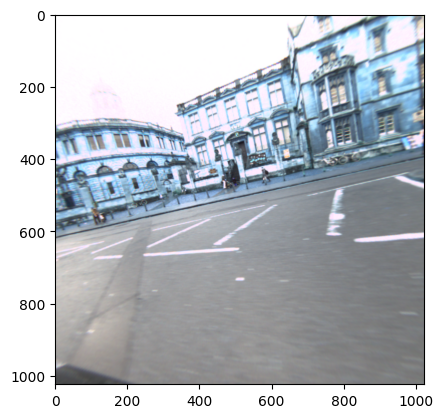

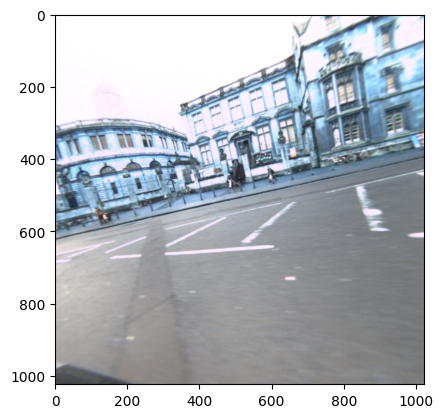

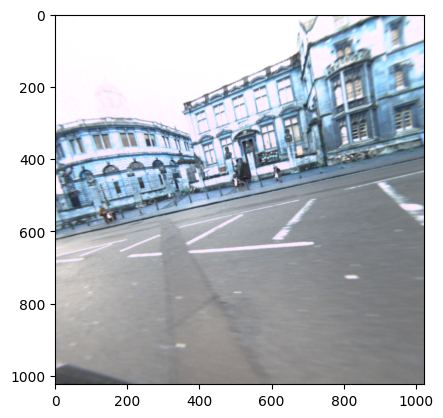

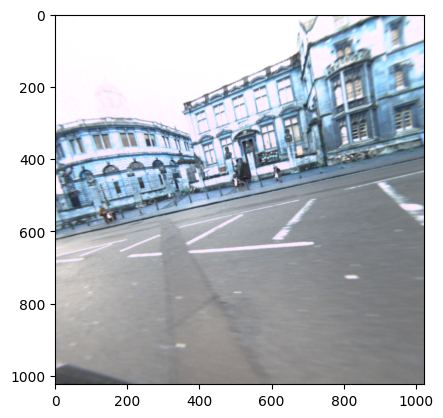

In [64]:
# looping through all images
for image in right_images:
    detect_cars(image)

#### Possible reason for false positives in above code output and areas of improvememt:
-----------------

The code may generate false positives for a number of different causes. One typical explanation is that the YOLO model may not be 100% accurate in identifying objects and occasionally wrongly classifies objects that aren't cars as cars. The threshold used to evaluate whether or not an object is an automobile could be another factor. This code considers items to be vehicles if their confidence score is larger than 0.5, which may result in some false positives.

In addition, the code sets a fixed size for input images of 416x416 pixels, which might not be ideal for all photos. For instance, the YOLO model might not be able to precisely recognize the cars in the image if they are either very small or very large.


### Areas of Improvement
---------

We can adjust the confidence threshold for object detection to improve its accuracy. Similarly, we can also adjust the NMS threshold to improve the accuracy of object detection.

To make the output more visually appealing, we can randomly assign different colors to different object types instead of hard-coding the bounding box color to dark red.

To improve the robustness of our implementation, we can include error handling and input validation features.

We should also check the format of the input image and convert it to RGB if necessary before processing it in our object detection algorithm.

To improve the performance of our implementation, we can break the image into smaller regions and process each region separately instead of processing the entire image at once.

### ROI Function to create a mask on the image
-------------------

In [46]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.

    Only keeps the region of the image defined by the polygon defined by "vertices".

    The rest of the image is set to black.
    """

    # Create a mask with the same shape as the input image, filled with zeros.
    mask = np.zeros_like(img)

    # Set the color to use when filling the mask based on the number of channels in the input image.
    ignore_mask_color = (255,) * img.shape[-1] if len(img.shape) > 2 else 255

    # Fill the polygon defined by the vertices with the fill color.
    cv2.fillPoly(mask, vertices, ignore_mask_color)

    # Apply the mask to the input image using bitwise AND.
    masked_image = cv2.bitwise_and(img, mask)

    return masked_image

### Detect Parking lanes
------------

The function first makes a copy of the input image and changes it to grayscale. Next, it applies Gaussian blur to reduce noise and Canny edge detection to find picture edges.

The function then specifies a region of interest and generates a mask by covering the area in white pixels. To retain only the edges within the region of interest, the mask is applied to the edges.


The function then performs morphological operations on the mask to smooth out the edges and fill in any gaps.

The Hough transform is then used by the function to identify lines in the image. Using the cv2.line function, the detected lines are traced on the original image.

In [36]:
def detect_lane_lines(image):
    """
    Detects lane lines in an image using computer vision techniques.

    Parameters:
    image (numpy.ndarray): The input image.
    """
    # Make a copy of the input image
    img = image.copy()

    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur and Canny edge detection
    blur = cv2.GaussianBlur(gray, (21, 21), 0)
    edges = cv2.Canny(blur, 50, 120)

    # Define region of interest and apply mask
    region = np.array([[(30, 450), (1024, 450), (1024, 745), (30, 745)]], dtype=np.int32)
    mask = np.zeros_like(edges)
    cv2.fillPoly(mask, region, 255)
    masked_edges = cv2.bitwise_and(edges, mask)

    # Apply morphological operations to fill gaps and smooth the mask
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (2, 2))
    closed_edges = cv2.morphologyEx(masked_edges, cv2.MORPH_CLOSE, kernel)

    # Apply Hough transform
    lines = cv2.HoughLinesP(closed_edges, 1, np.pi/180, 50, minLineLength=50, maxLineGap=20)

    # Draw lines on original image
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(img, (x1, y1), (x2, y2), (0, 255, 255), 3)

    show(img)


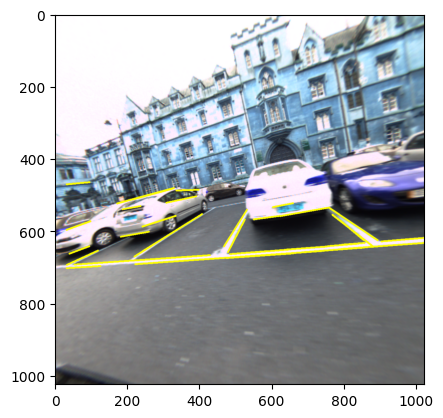

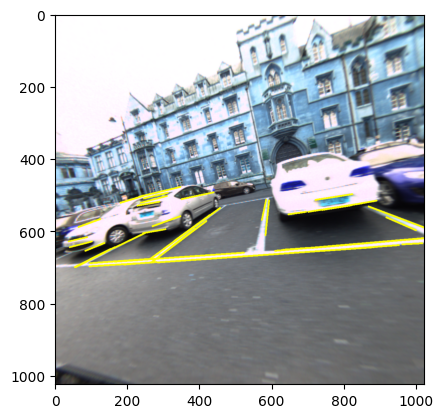

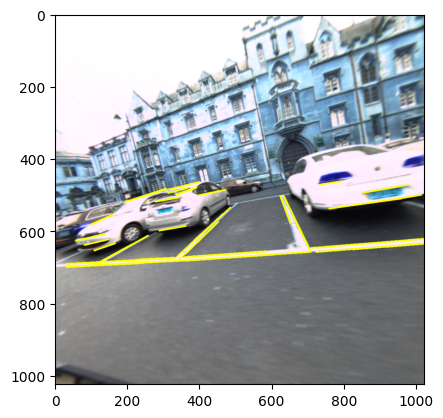

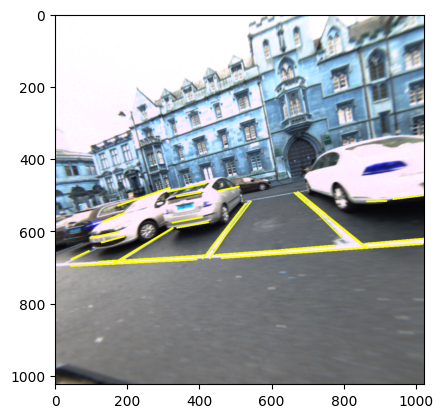

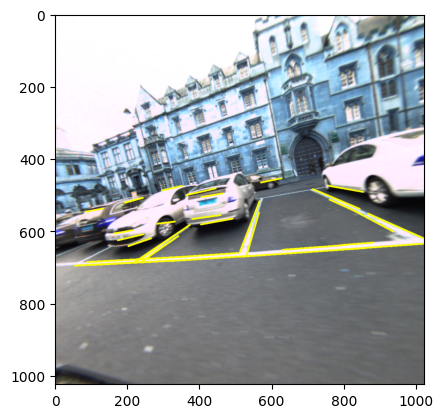

...

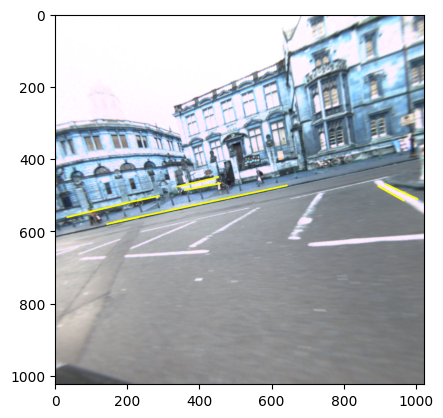

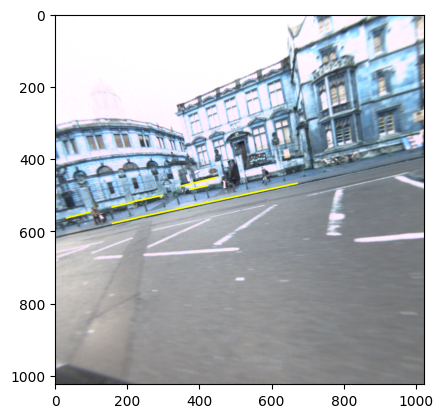

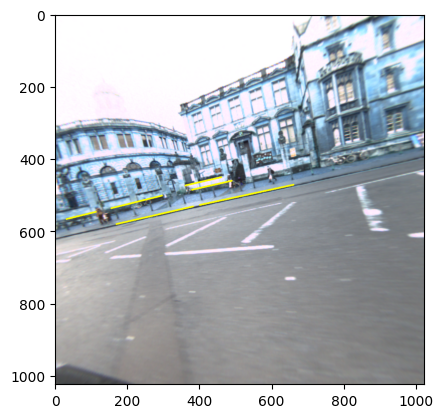

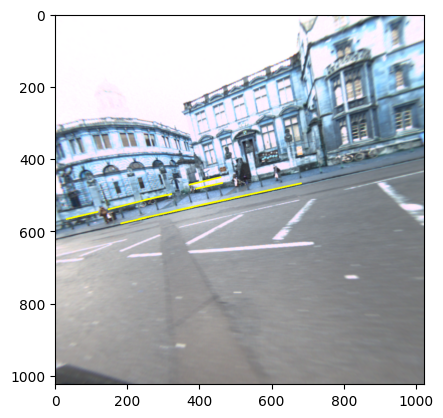

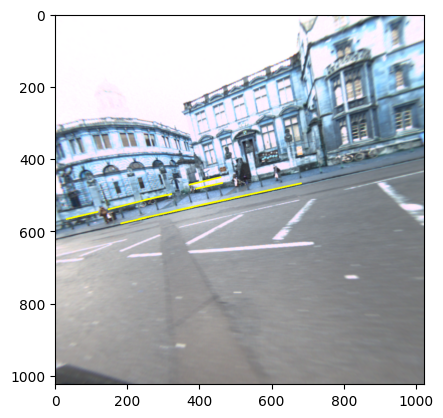

In [37]:
for image in right_images:
    detect_lane_lines(image)

#### Results -  Possiblity for False positives in parking slot detection:
---------------------

There are several false detections for available slots. It may be because of several reasons. Also, the Canny edge detector's threshold settings, for example, may not be the best choice for the particular input images given the edge detection parameters. When the thresholds are set too low, many edges that are not a part of the lane lines may be detected, while when they are set too high, significant edges that are a part of the lane lines may be overlooked.

It's possible that the region of interest (ROI) chosen is inappropriate for the particular photos being analyzed. For instance, false detections may result if the ROI does not include all of the necessary lane markings or if it includes portions of the image that are not on the road.

The parameters of the Hough transform, such as the minimum line length or the maximum space between

### Areas of Improvement
--------------------------
Parameter Tuning: The parameters used in the function are currently hardcoded. However, these values may not be optimal for different scenarios. Therefore, it is worth considering tuning the parameters for different inputs or using adaptive parameter selection based on the input image properties.

Handling of curved lane lines: The current function is designed to work well for straight lane lines. However, it may not perform well for curved lane lines. To handle curved lines, it may be worth considering using a more sophisticated algorithm that can detect curved lines, such as the Probabilistic Hough Transform.

Handling of shadows and changing lighting conditions: The function may not work well in different lighting conditions, and shadows may also interfere with the lane detection. To address this, one could consider using color thresholding to separate the lane lines from the rest of the image, or using machine learning techniques to handle changes in lighting and shadows.

Robustness to noise: The function may be sensitive to noise and could result in false detections. Therefore, it may be worth exploring techniques such as filtering or image denoising to reduce the impact of noise on the lane detection.

Performance optimization: The current implementation may not be efficient enough to process video streams in real-time. Therefore, it may be worth exploring optimization techniques such as parallelization, algorithmic optimizations, or hardware acceleration to improve the performance of the function.

## Empty slot detection:
-------------
For empty parking slot detection I have written a  function that applies a series of image processing steps such as grayscale conversion, histogram equalization, Gaussian blur, adaptive thresholding, masking, and morphological opening and closing. The function then identifies contours in the processed image and analyzes their aspect ratio and area to determine whether any of the contours represent empty parking slots. If an empty parking slot is detected, the function marks it by drawing a rectangle around it and displays the message "Available slot" on the image. In contrast, if no empty parking slots are found, the function displays the message "No available slot" on the image.

In [47]:
def detect_empty_parking_slot(image_array):
    # read the image
    rarrayD = image_array.copy()

    # convert to grayscale
    gray_image = cv2.cvtColor(rarrayD, cv2.COLOR_BGR2GRAY)

    # apply histogram equalization
    equ_image = cv2.equalizeHist(gray_image)

    # apply gaussian blur
    blur_image = cv2.GaussianBlur(equ_image, (5, 5), 0)

    # apply adaptive thresholding
    binary_image = cv2.adaptiveThreshold(blur_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)

    # define the region of interest
    region = np.int32([
        [
            (30, 500),
            (1024, 500),
            (1024, 745),
            (30, 745)
        ]
    ])

    # apply masking
    def region_of_interest(img, vertices):
        mask = np.zeros_like(img)
        match_mask_color = 255
        cv2.fillPoly(mask, vertices, match_mask_color)
        masked_image = cv2.bitwise_and(img, mask)
        return masked_image
    
    masked_img = region_of_interest(binary_image, region)

    # apply morphological opening and closing
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (2, 2))
    opening = cv2.morphologyEx(masked_img, cv2.MORPH_OPEN, kernel, iterations=3)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=3)

    # find contours
    contours, hierarchy = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    empty_slot_found = False

    # loop through each contour
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = float(w) / h
        area = cv2.contourArea(cnt)
        if 0.5 <= aspect_ratio <= 2.0 and 1500 <= area <= 5000:
            # a car is occupying the parking slot
            cv2.rectangle(rarrayD, (x, y), (x + w, y + h), (0, 255, 0), 3)
        else:
            # empty parking slot found
            empty_slot_found = True

    # check if any empty parking slot was found
    if empty_slot_found:
        cv2.putText(rarrayD, "Available slot", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 2)
    else:
        cv2.putText(rarrayD, "No available slot", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 0, 255), 2)

    show(rarrayD)

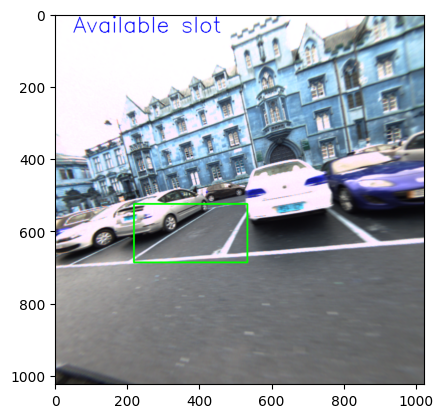

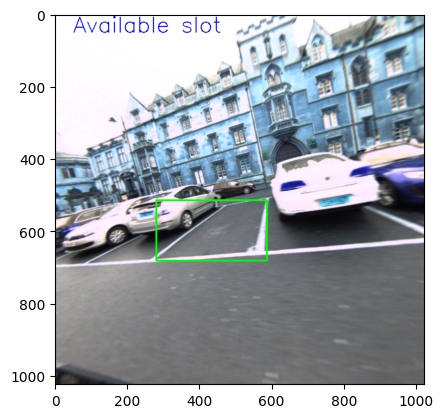

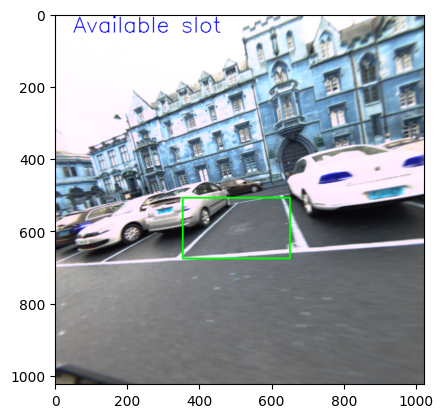

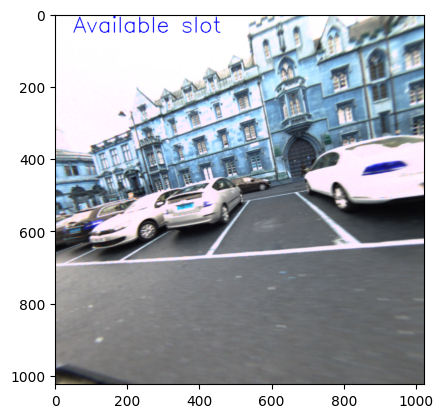

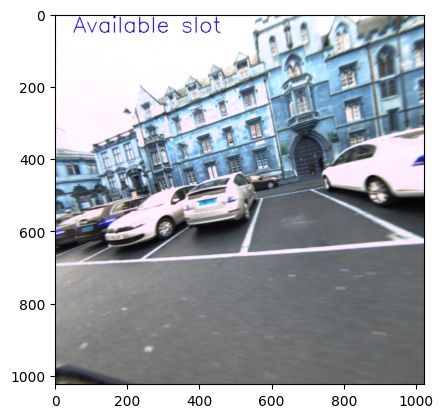

...

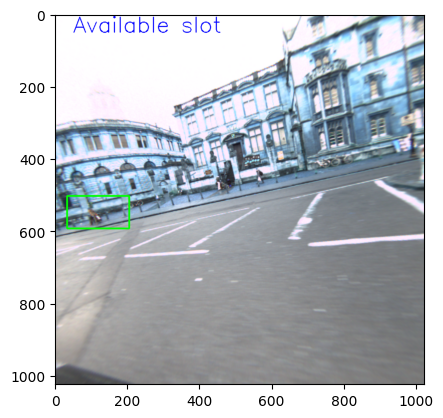

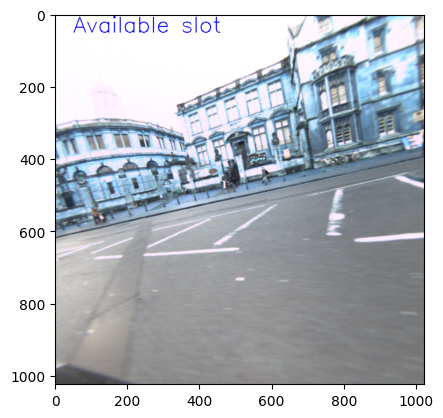

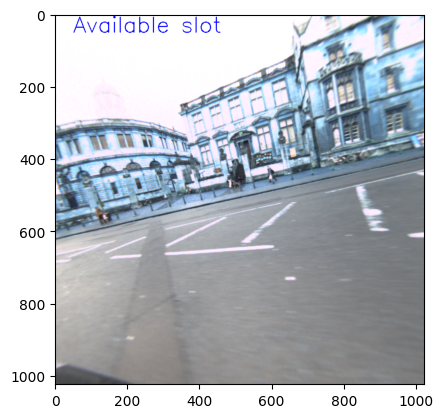

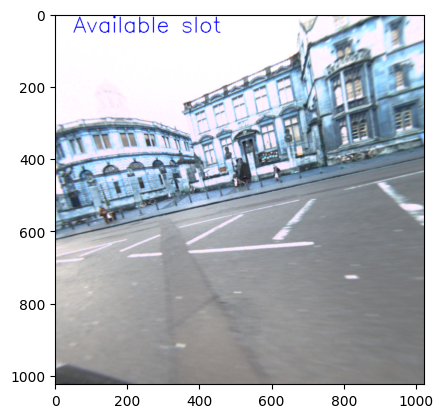

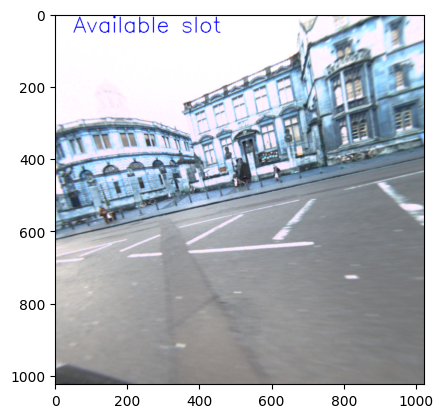

In [48]:
for image in right_images:
    detect_empty_parking_slot(image)

### Results - Reason for several false positives
The above function searches for specific sizes and shapes to identify parking spaces that are empty, but occasionally since cars dont accomodate full lanes they enable the code to become confused and believe the location is empty when it is actually full.

1. It only examines the portion of the image where the parking spaces are supposed to be, but occasionally it may include portions of the image that don't have parking spaces or overlook portions of the image that do, leading the code to mistakenly believe that a space is vacant when it is actually occupied.


2. It attempts to improve the image by removing noise and filling in any gaps, but occasionally it may go overboard.

### Areas of Improvement

Here are some ways to make the parking spot detection function work better:

1. Get more accurate with the area that the function looks at: Instead of just drawing a box around the parking spots,  method tcan re written to find exactly where the spots are. This would help make sure that the function only looks at the parts of the picture where the parking spots are.

2. Use a better way to turn the picture into black and white: The function currently uses a fixed way to decide which parts of the picture are black and which are white, but this might not work well for all pictures. A better way would be to look at the picture and figure out the best way to make it black and white based on what's in the picture.

3. Use better tools to clean up the picture: The current way the function cleans up the picture might be too rough and could cause some parking spots to disappear or get merged together. A better way would be to use a combination of tools that work well for the specific picture being analyzed. This would help make sure that all the parking spots are detected correctly.